In [7]:
import math
import os
import sys

import meep.adjoint as mpa
import numpy as np
from autograd import grad
from autograd import numpy as npa
from autograd import tensor_jacobian_product
from matplotlib import pyplot as plt
from matplotlib.patches import Circle
import seaborn as sns
from scipy import signal, special

import meep as mp
import nlopt  # need install nlopt
plt.style.use("seaborn")

%matplotlib inline
%config InlineBackend.figure_format = 'svg'
np.random.seed(0)

# mp.verbosity(0)
cur_path = os.getcwd()
save_path = cur_path + "/idea/"
if not os.path.exists(save_path):
    os.mkdir(save_path)

/tmp/ipykernel_287288/489241470.py:17: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


In [8]:
save_path

'/home/suda/inverse_design/grating_coupler/global_opt/positive_angle_quadratic/idea/'

# forward (0-25度)

设置不同角度的光源(0-25度) angle_reslution=0.2，光源的强度从0到25度线性降低，获取远场的强度分布并归一化

Vector3<7.800298083741103e-17, 1.2738853503184713, 0.0>
Vector3<0.0022233482368130717, 1.2738834100806211, 0.0>
Vector3<0.004446689700922036, 1.2738775893729812, 0.0>
Vector3<0.006670017619642722, 1.2738678882132823, 0.0>
Vector3<0.008893325220333278, 1.2738543066310761, 0.0>
Vector3<0.011116605730412607, 1.2738368446677342, 0.0>
Vector3<0.013339852377382989, 1.2738155023764486, 0.0>
Vector3<0.015563058388849854, 1.2737902798222318, 0.0>
Vector3<0.017786216992541848, 1.2737611770819162, 0.0>
Vector3<0.020009321416332316, 1.2737281942441536, 0.0>
Vector3<0.02223236488825936, 1.2736913314094156, 0.0>
Vector3<0.024455340636547314, 1.2736505886899925, 0.0>
Vector3<0.026678241889626815, 1.2736059662099941, 0.0>
Vector3<0.02890106187615457, 1.2735574641053482, 0.0>
Vector3<0.03112379382503598, 1.2735050825238001, 0.0>
Vector3<0.033346430965443485, 1.2734488216249136, 0.0>
Vector3<0.035568966526839184, 1.2733886815800692, 0.0>
Vector3<0.03779139373899458, 1.2733246625724637, 0.0>
Vector3<0.04

<Axes: xlabel='X', ylabel='Y'>

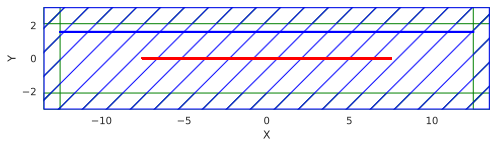

In [10]:
# if True compute flux (Gaussian source), if False compute DFT (Continue source)
compute_flux = True
# size of input and output waveguide
w = 0.5
h = 0.2

# resolution size
grid = 0.02
resolution = 1 / grid

# thickness of PML
dpml = 1

##################### length parameter ################
source_height = 0.5  # 与逆向设计中的meta_grarting区域保持一致
input_wvg_length = 5
output_wvg_length = 5
design_region_x = 15
design_region_y = 0.2
sx = input_wvg_length + design_region_x + output_wvg_length + 2 * dpml

##################### height parameter ################
Substrate_thickness = 0.5
BOX_thickness = 2
TOX_thickness = 0.7
near_field_height = 1
sy = BOX_thickness + TOX_thickness + Substrate_thickness + near_field_height + 2 * dpml

cell = mp.Vector3(sx, sy, 0)

# Material setting
Si = mp.Medium(index=3.45)
SiO2 = mp.Medium(index=1.44)
SiN = mp.Medium(index=1.96)


####################### Sources ##########################
wvl = 0.785
fcen = 1 / wvl
fwidth = 0.02 * fcen

start_angle = 0
stop_angle = 25
sources = []
angle_resolution = 0.1
for ii in range(0, int(stop_angle / angle_resolution) + 1, 1):
    angle = ii * angle_resolution
    rot_angle = angle
    k_point = mp.Vector3(fcen * 1).rotate(mp.Vector3(z=1), np.radians(90 - rot_angle))
    sources.append(
        mp.EigenModeSource(
            src=mp.GaussianSource(fcen, fwidth=fwidth),
            center=mp.Vector3(y=0),
            size=mp.Vector3(x=design_region_x),
            direction=mp.NO_DIRECTION,
            eig_kpoint=k_point,
            eig_band=1,
            eig_parity=mp.ODD_Z,
            eig_match_freq=True,
        )
    )
    print(k_point)
    # the amplitude of source is e_field, the intensity is square of e_field
    # the line amplitude means quadratic intensity
    sources[ii].amplitude = int(stop_angle / angle_resolution) - ii

# angle = 5
# rot_angle = angle
# k_point = mp.Vector3(fcen * 1).rotate(mp.Vector3(z=1), np.radians(90 - rot_angle))
# sources.append(
#     mp.EigenModeSource(
#         src=mp.GaussianSource(fcen, fwidth=fwidth),
#         center=mp.Vector3(y=0),
#         size=mp.Vector3(x=sx - 2 * dpml),
#         direction=mp.NO_DIRECTION,
#         eig_kpoint=k_point,
#         eig_band=1,
#         eig_parity=mp.ODD_Z,
#         eig_match_freq=True,
#     )
# )
# sources[0].amplitude = 2

# set nomrlized source: amplitude is 1 -> flux is 1
# sources[0].amplitude = 1 / mp.GaussianSource(fcen, fwidth=fwidth).fourier_transform(
#     fcen
# )

####################### Sources ##########################

sim = mp.Simulation(
    resolution=resolution,
    cell_size=cell,
    boundary_layers=[mp.PML(dpml)],
    sources=sources,
)

# ############### Monitor ###################
nfreq = 1


near_region = mp.FluxRegion(
    center=mp.Vector3(0, 0.5 * sy - dpml - 0.5 * near_field_height, 0),
    size=mp.Vector3(sx - 2 * dpml, 0),
)

near_field = sim.add_mode_monitor(
    fcen,
    fwidth,
    nfreq,
    near_region,
)

near_dft = sim.add_dft_fields(
    [mp.Ez], fcen, fwidth, nfreq, center=near_region.center, size=near_region.size
)

field_monitor = sim.add_dft_fields(
    [mp.Ez],
    fcen,
    fwidth,
    nfreq,
    center=mp.Vector3(),
    size=mp.Vector3(sx, sy),
)
# near2far_field
n2f_field = sim.add_near2far(
    fcen,
    0,
    nfreq,
    near_region,
)

# geometry plot
sim.plot2D()

In [45]:
# for source in sources:
#     print(source.eig_kpoint)

Vector3<7.800298083741103e-17, 1.2738853503184713, 0.0>
Vector3<0.11102642388236705, 1.269037831964007, 0.0>
Vector3<0.22120786963940178, 1.254532169442303, 0.0>
Vector3<0.3297057899395168, 1.2304787596039086, 0.0>
Vector3<0.4356944500963934, 1.1970606634215393, 0.0>
Vector3<0.5383672124085342, 1.1545322127855413, 0.0>


-----------
Initializing structure...
time for choose_chunkdivision = 0.000333071 s
Working in 2D dimensions.
Computational cell is 27 x 6.2 x 0 with resolution 50


time for set_epsilon = 0.384339 s
-----------
MPB solved for frequency_1(7.8003e-17,1.27389,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.00222335,1.27388,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.00444669,1.27388,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.00667002,1.27387,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.00889333,1.27385,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.0111166,1.27384,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.0133399,1.27382,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.0155631,1.27379,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.0177862,1.27376,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.0200093,1.27373,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.0222324,1.27369,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.0244553,1.27365,0) = 1.27389 after 97 iters
MPB solved for frequency_1(0.0266782,1.27361,0) = 1.27389 after 97 iters


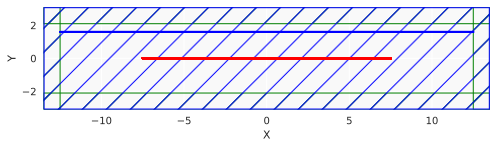

In [11]:
mpt = mp.Vector3(0, 0.5 * sy - dpml - 0.5 * near_field_height, 0)

f = plt.figure(dpi=100)
Animate = mp.Animate2D(fields=mp.Ez, f=f, realtime=False, normalize=True)

sim.run(
    mp.at_every(1, Animate),
    until_after_sources=mp.stop_when_fields_decayed(50, mp.Ez, mpt, 1e-5),
)

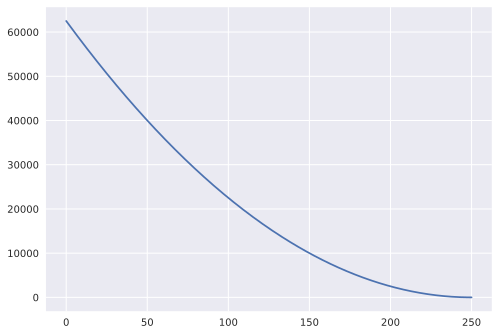

In [12]:
amplitudes = []
for source in sources:
    amplitudes.append(source.amplitude)
plt.plot(
    range(0, int(stop_angle / angle_resolution) + 1, 1),
    np.power(np.array(amplitudes), 2),
)

In [13]:
Animate.to_jshtml(fps=1)

**DFT field** 

In [14]:
output_dft = sim.get_dft_array(near_dft, mp.Ez, 0)
[x, y, z, w] = sim.get_array_metadata(dft_cell=near_dft) # type: ignore

236366606002.63123


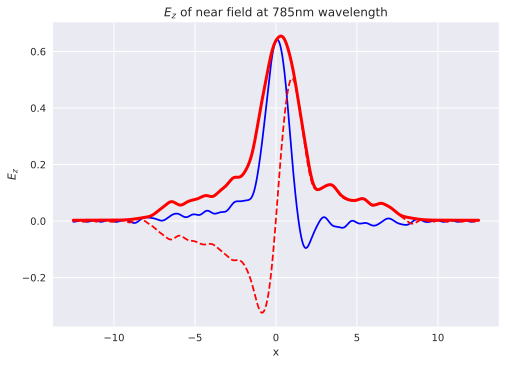

In [15]:
# normalize the output_dft
figure, ax = plt.subplots()
total_power = np.sum(np.abs(output_dft) ** 2 * (x[1] - x[0]))
print(total_power)
norm_output_dft = output_dft / np.sqrt(total_power)
plt.plot(x, np.real(norm_output_dft), "-b")
plt.plot(x, np.imag(norm_output_dft), "--r")
plt.plot(x, np.abs(norm_output_dft), "-r", linewidth=3)
plt.title(r"$ E_z $ of near field at 785nm wavelength")
ax.set_xlabel("x")
ax.set_ylabel(r"$ E_z $")
np.save(save_path + "near_field.npy", norm_output_dft)

In [8]:
# obj = max(sum(E*conj(E)))
# print(np.abs(np.sum(norm_output_dft * np.conj(norm_output_dft))))

In [16]:
print(np.sum(np.abs(norm_output_dft)**2*(x[1]-x[0])))

0.9999999999999999


In [10]:
# input_mode = sim.get_eigenmode_coefficients(
#     near_field, list(range(1, 26, 1)), eig_parity=mp.EVEN_Y + mp.ODD_Z
# )
# input_mode_coe = np.squeeze(input_mode.alpha)
# input_flux = mp.get_fluxes(near_field)
# print(f"根据eigenmode_coe[0]计算得到的flux: {abs(input_mode_coe[0]) ** 2}")
# print(f"根据flux计算得到的flux: {input_flux}")
# print(f'逆向eigenmode_coe[0]: {abs(input_mode_coe[1]) ** 2}')
# print(f"逆向eigenmode_coe[1]: {abs(input_mode_coe[1]) ** 2}")

The angle of maximum intensity is 1.7965078887701955


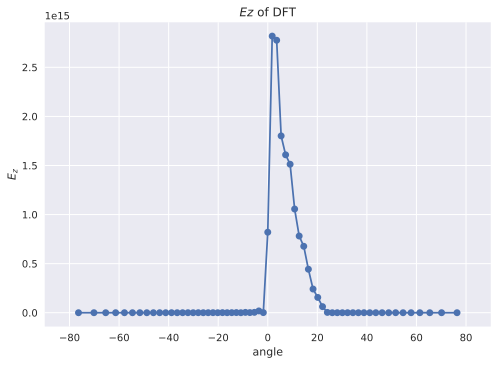

In [17]:
# dft ot near field
kx = np.fft.fftshift(np.fft.fftfreq(len(x), grid))
near_field_fft = np.fft.fftshift(np.fft.fft(output_dft))

k = 1 / wvl
kx[np.abs(kx) > k] = np.nan
angle = np.arcsin(kx / k) * 180 / np.pi

figure, ax = plt.subplots()
plt.plot(angle, np.abs(near_field_fft) ** 2, "-o")
# plt.scatter(angle, near_field_fft)
plt.title(r"$ Ez $ of DFT")
ax.set_xlabel("angle")
ax.set_ylabel(r"$ E_z $")
ax.set_xlim(-90, 90)

max_index = np.argmax(np.abs(near_field_fft) ** 2)
print(f"The angle of maximum intensity is {angle[max_index]}")


source.amplitude is 1, flux is 15.4

In [18]:
am = 1 / mp.GaussianSource(fcen, fwidth=fwidth).fourier_transform(fcen)
print(np.abs(am))
print((1 / np.abs(am)) ** 2)  


0.025477707006369428
1540.5625


**Field monitor**

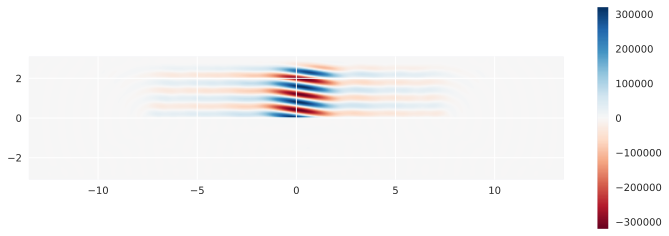

In [19]:
field_data = sim.get_dft_array(field_monitor, mp.Ez, 0)
field_eps = sim.get_array(
    component=mp.Permeability, center=mp.Vector3(), size=mp.Vector3(sx, sy)
)
[x, y, z, w] = sim.get_array_metadata(dft_cell=field_monitor)
x_grid, y_grid = np.meshgrid(x, y)
plt.figure(figsize=(12, 4))
# plt.pcolormesh(x_grid, y_grid, field_eps.transpose(), cmap="binary")
field_data = np.flipud(field_data.transpose())
# plt.imshow(np.angle(field_data[:][0:100])* np.abs(field_data[:][0:100]), cmap="RdBu")
# plot x and y axis
plt.imshow(np.real(field_data[:]), cmap="RdBu", extent=[x[0], x[-1], y[0], y[-1]])
# plt.xticks([src_region.center.x, out_region.center.x])
# plt.yticks([0.5])
plt.colorbar()

**far field**

Output_angle of grating coupler: 2.6140995240304914 degree
max of far field: 1602882.7202666672


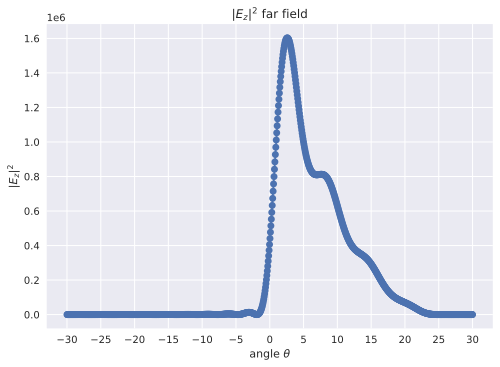

In [35]:
# anzhao1dianshu1
ff_distance = 1e6  # far-field distance from near-field monitor
ff_angle = 30  # far-field cone angle
ff_npts = 1000  # number of far-field points
# single-side far-field length
ff_length = ff_distance * math.tan(math.radians(ff_angle))  # far-field length
# [-ff_length, ff_length]
ff_lengths = np.linspace(-ff_length, ff_length, ff_npts)  # far-field lengths
# resolution
ff_res = ff_npts / (2 * ff_length)  # far-field length resolution

ff = sim.get_farfields(
    n2f_field,
    ff_res,
    center=mp.Vector3(0, ff_distance),
    size=mp.Vector3(x=2 * ff_length),
)
# [-angle, angle]
angles = [math.degrees(math.atan(f)) for f in ff_lengths / ff_distance]
rel_enh = np.abs(ff["Ez"]) ** 2

figure, ax = plt.subplots()
plt.plot(angles, rel_enh, "-o")
plt.title(r"$ {|E_z|}^2 $ far field")
ax.set_xlabel(r"angle $ \theta $")
ax.set_ylabel(r"$ {|E_z|}^2 $")
ax.set_xticks(range(-30, 35, 5))
index = np.argmax(rel_enh)
print(f"Output_angle of grating coupler: {angles[index]} degree")
print(f"max of far field: {np.max(rel_enh)}")

计算总场power

In [21]:
total_power = mp.get_fluxes(near_field)
print(total_power)

[236146319014.19788]


Text(0, 0.5, '$ {|E_z|}^2 $')

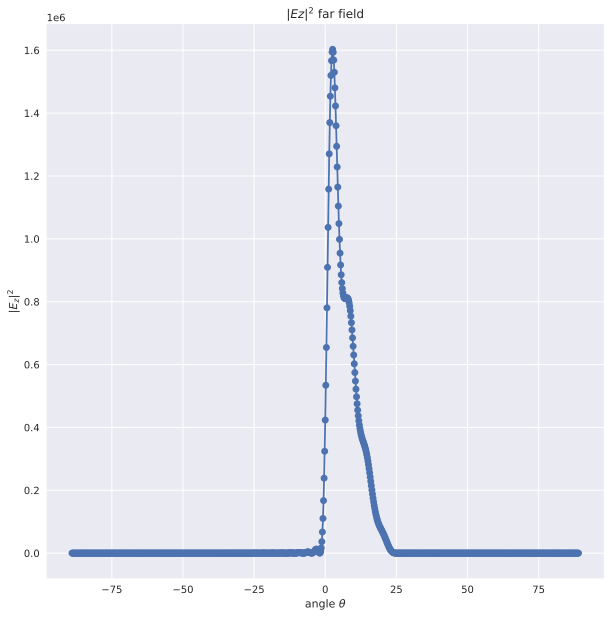

In [34]:
# 验证在0-25度光源传播下，monitor的远场角度分布
# 设置角度的分辨率为 0.2degree
d_angle = 0.2
ff_distance = 1e6
ff_angle = 89
ff_number = int(2 / d_angle) * ff_angle + 1
ff_angles = np.linspace(-ff_angle, ff_angle, ff_number)
ff_points = [
    mp.Vector3(fx, 1e6, 0) for fx in np.tan(np.radians(ff_angles)) * ff_distance
]

ob_list = [sim.get_farfield(n2f_field, ff_point) for ff_point in ff_points]
n2f_angle_Ez = [Ez[2] for Ez in ob_list]
rel_enh = np.abs(n2f_angle_Ez) ** 2
figure, ax = plt.subplots(figsize=(10, 10))
plt.plot(ff_angles, rel_enh, "-o")
plt.title(r"$ {|Ez|}^2 $ far field")
ax.set_xlabel(r"angle $ \theta$")
ax.set_ylabel(r"$ {|E_z|}^2 $")

In [26]:
ff_angles

array([-89. , -88.8, -88.6, -88.4, -88.2, -88. , -87.8, -87.6, -87.4,
       -87.2, -87. , -86.8, -86.6, -86.4, -86.2, -86. , -85.8, -85.6,
       -85.4, -85.2, -85. , -84.8, -84.6, -84.4, -84.2, -84. , -83.8,
       -83.6, -83.4, -83.2, -83. , -82.8, -82.6, -82.4, -82.2, -82. ,
       -81.8, -81.6, -81.4, -81.2, -81. , -80.8, -80.6, -80.4, -80.2,
       -80. , -79.8, -79.6, -79.4, -79.2, -79. , -78.8, -78.6, -78.4,
       -78.2, -78. , -77.8, -77.6, -77.4, -77.2, -77. , -76.8, -76.6,
       -76.4, -76.2, -76. , -75.8, -75.6, -75.4, -75.2, -75. , -74.8,
       -74.6, -74.4, -74.2, -74. , -73.8, -73.6, -73.4, -73.2, -73. ,
       -72.8, -72.6, -72.4, -72.2, -72. , -71.8, -71.6, -71.4, -71.2,
       -71. , -70.8, -70.6, -70.4, -70.2, -70. , -69.8, -69.6, -69.4,
       -69.2, -69. , -68.8, -68.6, -68.4, -68.2, -68. , -67.8, -67.6,
       -67.4, -67.2, -67. , -66.8, -66.6, -66.4, -66.2, -66. , -65.8,
       -65.6, -65.4, -65.2, -65. , -64.8, -64.6, -64.4, -64.2, -64. ,
       -63.8, -63.6,

**验证far field计算得到的power与mp.get_fluxes()相等**

In [27]:
d_length = []
for angle in ff_angles:
    # The length of each angle in the far field
    length = ff_distance / np.cos(np.radians(angle))
    d_length.append(np.radians(d_angle) * length)

print(f"The total length {np.sum(d_length)} um calculated by angles")

energy = 0
for ii in range(0, ff_number, 1):
    energy = energy + d_length[ii] * (np.abs(n2f_angle_Ez[ii]) ** 2)
print(f"The power of near_field is {energy}")

near_field_flux = mp.get_fluxes(near_field)
print(f"The power of near_field is {near_field_flux[0]}")

The total length 9689347.824509013 um calculated by angles
The power of near_field is 236920552846.49902
The power of near_field is 236146319014.19788


**Normalized power: 1**

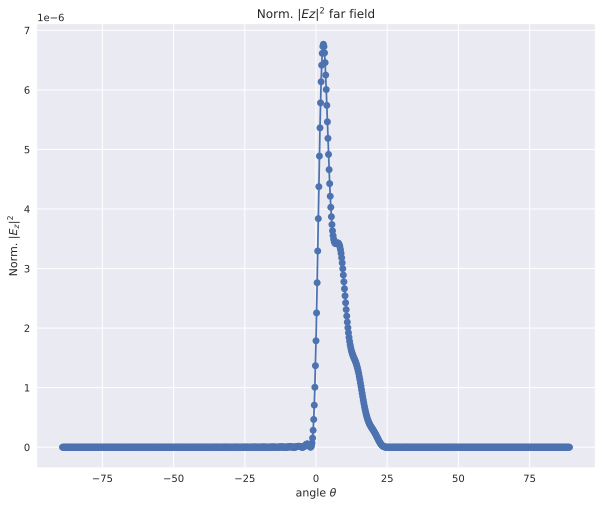

In [31]:
norm_rel = rel_enh / energy
figure, ax = plt.subplots(figsize=(10, 8))
plt.plot(ff_angles, norm_rel, "-o")
plt.title(r"Norm. $ {|Ez|}^2 $ far field")
ax.set_xlabel(r"angle $ \theta$")
ax.set_ylabel(r"Norm. $ {|E_z|}^2 $")
np.save(save_path + "far_field.npy", norm_rel)


In [32]:
norm_rel.shape

(891,)

**验证归一化之后的enegy is 1**

In [33]:
norm_energy = 0
for ii in range(0, ff_number, 1):
    norm_energy = norm_energy + d_length[ii] * (norm_rel[ii])
print(f"The power of near_field is {norm_energy}")


The power of near_field is 0.9999999999999987


In [21]:
# norm_rel_load = np.load('norm_rel.npy')
# figure= plt.figure(figsize=(10, 10))
# plt.plot(ff_angles, norm_rel_load, "-o")


# forward (-25-0度)

当光栅周期较小时，会出现光栅的矢量大于波导的传播常数，会使得出射光束在负方向，因此考虑到最下化grating coupler的尺寸，尝试在负方向 (**-25-0度**) 远场分布


<Axes: xlabel='X', ylabel='Y'>

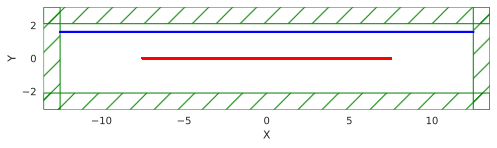

In [22]:
# if True compute flux (Gaussian source), if False compute DFT (Continue source)
compute_flux = True
# size of input and output waveguide
w = 0.5
h = 0.2

# resolution size
grid = 0.02
resolution = 1 / grid

# thickness of PML
dpml = 1

##################### length parameter ################
source_height = 0.5  # 与逆向设计中的meta_grarting区域保持一致
input_wvg_length = 5
output_wvg_length = 5
design_region_x = 15
design_region_y = 0.2
sx = input_wvg_length + design_region_x + output_wvg_length + 2 * dpml

##################### height parameter ################
Substrate_thickness = 0.5
BOX_thickness = 2
TOX_thickness = 0.7
near_field_height = 1
sy = BOX_thickness + TOX_thickness + Substrate_thickness + near_field_height + 2 * dpml

cell = mp.Vector3(sx, sy, 0)

# Material setting
Si = mp.Medium(index=3.45)
SiO2 = mp.Medium(index=1.44)
SiN = mp.Medium(index=1.96)


####################### Sources ##########################
wvl = 0.785
fcen = 1 / wvl
fwidth = 0.2 * fcen

start_angle = 0
stop_angle = 25
sources = []
angle_resolution = 0.1
for ii in range(0, int(stop_angle / angle_resolution) + 1, 1):
    angle = ii * angle_resolution
    rot_angle = angle
    # 修改 k_point 角度从(0, 25) -> (0, -25)
    k_point = mp.Vector3(fcen * 1).rotate(mp.Vector3(z=1), np.radians(90 + rot_angle))
    sources.append(
        mp.EigenModeSource(
            src=mp.GaussianSource(fcen, fwidth=fwidth),
            center=mp.Vector3(y=0),
            size=mp.Vector3(x=design_region_x),
            direction=mp.NO_DIRECTION,
            eig_kpoint=k_point,
            eig_band=1,
            eig_parity=mp.ODD_Z,
            eig_match_freq=True,
        )
    )
    # the amplitude of source is e_field, the intensity is square of e_field
    sources[ii].amplitude = np.sqrt(int(stop_angle / angle_resolution) - ii)

# angle = 5
# rot_angle = angle
# k_point = mp.Vector3(fcen * 1).rotate(mp.Vector3(z=1), np.radians(90 - rot_angle))
# sources.append(
#     mp.EigenModeSource(
#         src=mp.GaussianSource(fcen, fwidth=fwidth),
#         center=mp.Vector3(y=0),
#         size=mp.Vector3(x=sx - 2 * dpml),
#         direction=mp.NO_DIRECTION,
#         eig_kpoint=k_point,
#         eig_band=1,
#         eig_parity=mp.ODD_Z,
#         eig_match_freq=True,
#     )
# )
# sources[0].amplitude = 2

# set nomrlized source: amplitude is 1 -> flux is 1
# sources[0].amplitude = 1 / mp.GaussianSource(fcen, fwidth=fwidth).fourier_transform(
#     fcen
# )

####################### Sources ##########################

sim = mp.Simulation(
    resolution=resolution,
    cell_size=cell,
    boundary_layers=[mp.PML(dpml)],
    sources=sources,
)

# ############### Monitor ###################
nfreq = 1


near_region = mp.FluxRegion(
    center=mp.Vector3(0, 0.5 * sy - dpml - 0.5 * near_field_height, 0),
    size=mp.Vector3(sx - 2 * dpml, 0),
)

near_field = sim.add_mode_monitor(
    fcen,
    fwidth,
    nfreq,
    near_region,
)

near_dft = sim.add_dft_fields(
    [mp.Ez], fcen, fwidth, nfreq, center=near_region.center, size=near_region.size
)

# near2far_field
n2f_field = sim.add_near2far(
    fcen,
    0,
    nfreq,
    near_region,
)

# geometry plot
sim.plot2D()

-----------
Initializing structure...
time for choose_chunkdivision = 0.00032711 s
Working in 2D dimensions.
Computational cell is 27 x 6.2 x 0 with resolution 50


time for set_epsilon = 0.350218 s
-----------
MPB solved for frequency_1(7.8003e-17,1.27389,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.00222335,1.27388,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.00444669,1.27388,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.00667002,1.27387,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.00889333,1.27385,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.0111166,1.27384,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.0133399,1.27382,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.0155631,1.27379,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.0177862,1.27376,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.0200093,1.27373,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.0222324,1.27369,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.0244553,1.27365,0) = 1.27389 after 97 iters
MPB solved for frequency_1(-0.0266782,1.27361,0) = 1.27389 aft

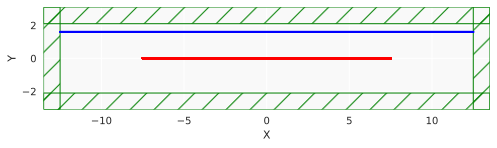

In [23]:
mpt = mp.Vector3(0, 0.5 * sy - dpml - 0.5 * near_field_height, 0)

f = plt.figure(dpi=100)
Animate = mp.Animate2D(fields=mp.Ez, f=f, realtime=False, normalize=True)

sim.run(
    mp.at_every(1, Animate),
    until_after_sources=mp.stop_when_fields_decayed(50, mp.Ez, mpt, 1e-5),
)

In [24]:
filename = "base_simulation_angle_source.mp4"
Animate.to_mp4(10, filename)

from IPython.core.display import Video

Video(filename)

Generating MP4...


14518329.313744918


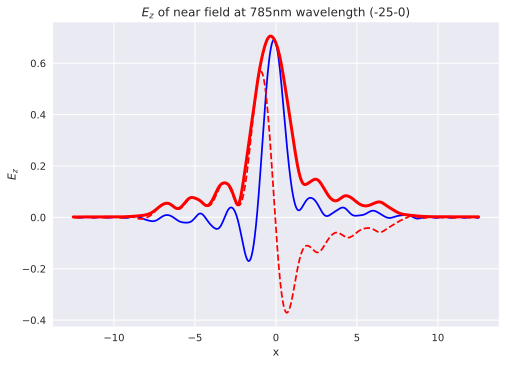

In [25]:
output_dft = sim.get_dft_array(near_dft, mp.Ez, 0)
[x, y, z, w] = sim.get_array_metadata(dft_cell=near_dft)  # type: ignore
figure, ax = plt.subplots()
total_power = np.sum(np.abs(output_dft) ** 2 * (x[1] - x[0]))
print(total_power)
norm_output_dft = output_dft / np.sqrt(total_power)
plt.plot(x, np.real(norm_output_dft), "-b")
plt.plot(x, np.imag(norm_output_dft), "--r")
plt.plot(x, np.abs(norm_output_dft), "-r", linewidth=3)
plt.title(r"$ E_z $ of near field at 785nm wavelength (-25-0)")
ax.set_xlabel("x")
ax.set_ylabel(r"$ E_z $")
np.save("near_field.npy", norm_output_dft)

In [26]:
print(np.abs(np.sum(norm_output_dft * np.conj(norm_output_dft))))

50.000000000001066


Output_angle of grating coupler: -2.7462612353703135 degree
max of far field: 8.439743097320575


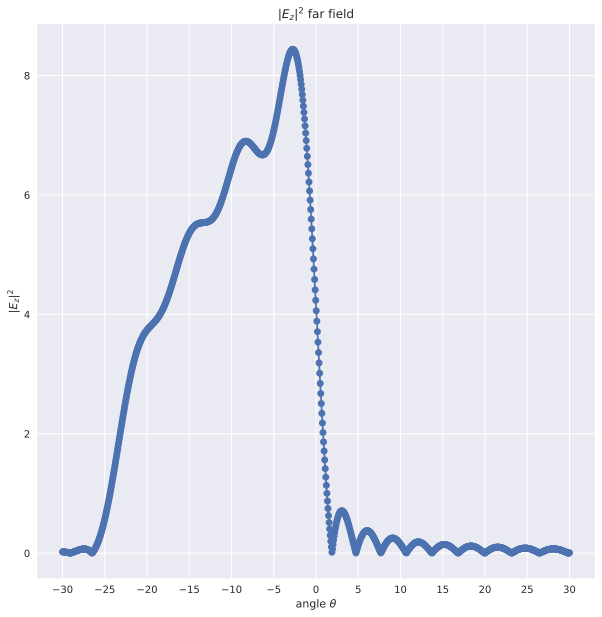

In [27]:
ff_distance = 1e6  # far-field distance from near-field monitor
ff_angle = 30  # far-field cone angle
ff_npts = 1000  # number of far-field points
# single-side far-field length
ff_length = ff_distance * math.tan(math.radians(ff_angle))  # far-field length
# [-ff_length, ff_length]
ff_lengths = np.linspace(-ff_length, ff_length, ff_npts)  # far-field lengths
# resolution
ff_res = ff_npts / (2 * ff_length)  # far-field length resolution

ff = sim.get_farfields(
    n2f_field,
    ff_res,
    center=mp.Vector3(0, ff_distance),
    size=mp.Vector3(x=2 * ff_length),
)
# [-angle, angle]
angles = [math.degrees(math.atan(f)) for f in ff_lengths / ff_distance]
rel_enh = np.abs(ff["Ez"])

figure, ax = plt.subplots(figsize=(10, 10))
plt.plot(angles, rel_enh, "-o")
plt.title(r"$ {|E_z|}^2 $ far field")
ax.set_xlabel(r"angle $ \theta $")
ax.set_ylabel(r"$ {|E_z|}^2 $")
ax.set_xticks(range(-30, 35, 5))
index = np.argmax(rel_enh)
print(f"Output_angle of grating coupler: {angles[index]} degree")
print(f"max of far field: {np.max(rel_enh)}")